In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import random
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from matplotlib.transforms import Affine2D
from IPython.display import HTML


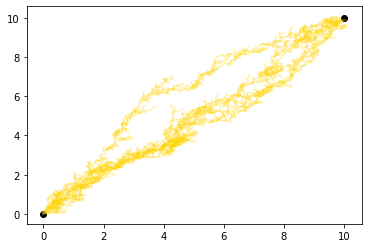

In [11]:
%matplotlib inline
pos1 = [0,0]
pos2 = [10,10]

segSize = .1

plt.plot([pos1[0],pos2[0]],[pos1[1],pos2[1]],'ok')

for i in range(4):
    closed = False
    position = [pos1]
    allPos = [pos1]
    allAngles = [np.arctan2(pos2[1]-pos1[1],pos2[0]-pos1[0])]
    while closed == False:
        #find angle between pos and pos2
        oldPosition = position
        for n,oldPos,pos in zip(range(len(position)),oldPosition, position):
            angle = np.arctan2(pos2[1]-pos[1],pos2[0]-pos[0]) + random.uniform(-np.pi/2,np.pi/2)
            #find new pos
            posNew = segSize*np.array([np.cos(angle),np.sin(angle)])+pos
            position[n] = posNew
            allPos.append(posNew)
            allAngles.append(angle)
            plt.plot([oldPos[0],posNew[0]],[oldPos[1],posNew[1]],'gold', alpha =0.2)
    
    
            randNum = random.randint(0,6)
            if randNum < 3:
                angle = np.arctan2(pos2[1]-pos[1],pos2[0]-pos[0]) + random.uniform(-np.pi/2,np.pi/2)
                posNew = segSize*np.array([np.cos(angle),np.sin(angle)])+pos
                position.append(posNew)
                allPos.append(posNew)
                allAngles.append(angle)
                plt.plot([oldPos[0],posNew[0]],[oldPos[1],posNew[1]],'gold', alpha =0.2)

            if randNum >= 3 and len(position) > 3:
                position.pop(random.randint(0,len(position)-1))        
            
            elif len(position) > 50:
                position.pop(random.randint(0,len(position)-1))  

            #check if close
            if pos[0] > pos2[0] or pos[1] > pos2[1]:
                closed = True

plt.show()

In [109]:
%matplotlib notebook

fig,ax = plt.subplots(1)
ax.set_xlim(pos1[0],pos2[0])
ax.set_ylim(pos1[1],pos2[1])

def update(frame):
    #plot a rectangle at position x and angle y
    x = allPos[frame+1][0]
    y = allPos[frame+1][1]
    angle = allAngles[frame]*180/np.pi+90
    x -= segSize/2*np.cos(angle*np.pi/180)
    y -= segSize/20*np.sin(angle*np.pi/180)
    rect = Rectangle((x, y), width=segSize, height=segSize/10, angle=angle, fill=True)
    # rect.set_transform(Affine2D().rotate_deg(angle))
    ax.add_patch(rect)


ani = animation.FuncAnimation(fig, update, frames=len(allPos)-1, interval=1, repeat=False)
HTML(ani.to_jshtml())

<IPython.core.display.Javascript object>

Animation size has reached 21003394 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
